<center>
<img src="FIFA-19-Background-1-768x401.jpg" />

## Aprendizaje No Supervisado 2020 DiploDatos
    Laura Alonso Alemany, Ana Georgina Flesia y Valeria Rulloni
## Agrupamiento con el FIFA 2020 dataset
    
Material basado en notas de Ana Georgina Flesia bajo los términos y condiciones de la licencia [Creative Commons CC BY-NC-SA 4.0](https://creativecommons.org/licenses/by-nc-sa/4.0/), a su vez basado de material de [SilveMel](https://www.kaggle.com/karangadiya/fifa19/downloads/data.csv/comments) y otros.

### Indice de temas
1. [Inicialización del entorno](#1.-Inicialización-del-entorno)
2. [Exploración de la Base](#2.-Exploración-de-la-base)
3. [Preparación de los datos](#3.-Preparación-de-los-datos)
4. [Clustering Visual](#3.-Exploratorio-Visual-para-Clustering)

## 1.-Inicialización-del-entorno

**Empezamos cargando algunas herramientas para cargar los datos y manipularlos.**

In [402]:
import numpy as np
import pandas as pd
pd.set_option('display.max_columns',100)
pd.set_option('display.max_rows',1000)
import itertools
import warnings
warnings.filterwarnings("ignore")
import io

**Para visualización usaremos principalmente plotly, también seaborn y matplotlib.**

In [403]:
from plotly.offline import init_notebook_mode, plot,iplot
import plotly.graph_objs as go
init_notebook_mode(connected=True)
import matplotlib.pyplot as plt
import plotly.tools as tls#visualization
import plotly.figure_factory as ff#visualization
import seaborn as sns

from sklearn.cluster import KMeans, MeanShift

## Análisis Exploratorio

In [404]:
df_original=pd.read_csv("players_20.csv")
df_original.sample(4)

,sofifa_id,player_url,short_name,long_name,age,dob,height_cm,weight_kg,nationality,club,overall,potential,value_eur,wage_eur,player_positions,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,release_clause_eur,player_tags,team_position,team_jersey_number,loaned_from,joined,contract_valid_until,nation_position,nation_jersey_number,pace,shooting,passing,dribbling,defending,physic,gk_diving,gk_handling,gk_kicking,gk_reflexes,gk_speed,gk_positioning,player_traits,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,...,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb
7048,221144,https://sofifa.com/player/221144/alain-oyarzun...,Alain Oyarzun,Alain Oyarzun Aguilar,25,1993-09-27,178,71,Spain,CD Numancia,68,71,1100000,5000,"LM, LW",Left,1,3,3,High/Medium,Normal,No,1800000.0,NaN,LM,10.0,NaN,2018-07-02,2020.0,NaN,NaN,72.0,64.0,67.0,70.0,48.0,56.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,69,64,46,67,53,70,...,73,71,83,62,72,63,72,49,57,68,58,43,62,69,60,66,54,49,42,12,6,14,14,15,62+2,62+2,62+2,67+2,66+2,66+2,66+2,67+2,67+2,67+2,67+2,66+2,63+2,63+2,63+2,66+2,57+2,56+2,56+2,56+2,57+2,55+2,52+2,52+2,52+2,55+2
11049,243632,https://sofifa.com/player/243632/charles-abi/2...,C. Abi,Charles Abi,19,2000-04-12,187,71,France,AS Saint-Étienne,64,80,975000,4000,"LW, ST",Left,1,3,3,Medium/Medium,Lean,No,2500000.0,NaN,SUB,34.0,NaN,2018-04-25,2022.0,NaN,NaN,79.0,59.0,55.0,66.0,21.0,55.0,NaN,NaN,NaN,NaN,NaN,NaN,Early Crosser,59,60,63,62,56,69,...,79,79,68,56,44,63,64,60,62,53,30,19,61,54,66,46,17,13,22,9,11,7,11,14,63+2,63+2,63+2,64+2,63+2,63+2,63+2,64+2,61+2,61+2,61+2,63+2,53+2,53+2,53+2,63+2,46+2,39+2,39+2,39+2,46+2,43+2,35+2,35+2,35+2,43+2
3003,165735,https://sofifa.com/player/165735/brad-jones/20...,B. Jones,Brad Jones,37,1982-03-19,193,87,Australia,Al Nassr,73,73,400000,14000,GK,Left,1,2,1,Medium/Medium,Normal,No,680000.0,NaN,GK,1.0,NaN,2018-08-01,2020.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,71.0,69.0,68.0,71.0,54.0,75.0,"Flair, Acrobatic Clearance",19,17,11,28,11,18,...,52,55,25,75,30,51,70,40,72,11,32,23,17,30,35,56,17,13,13,71,69,68,75,71,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6321,183188,https://sofifa.com/player/183188/marcello-gazz...,M. Gazzola,Marcello Gazzola,34,1985-04-03,183,77,Italy,Parma,69,69,375000,17000,RB,Right,1,3,3,High/Medium,Normal,No,675000.0,NaN,SUB,23.0,NaN,2018-01-16,2022.0,NaN,NaN,67.0,49.0,56.0,66.0,66.0,69.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,65,40,64,60,34,64,...,72,62,69,76,61,62,65,75,67,55,68,74,61,42,49,68,60,67,66,5,7,9,15,12,59+2,59+2,59+2,61+2,60+2,60+2,60+2,61+2,59+2,59+2,59+2,62+2,61+2,61+2,61+2,62+2,67+2,65+2,65+2,65+2,67+2,67+2,66+2,66+2,66+2,67+2


**Veamos cuantos jugadores hay y cuantos equipos**

In [405]:
print("Cantidad de Jugadores:", len(df_original))
print("Cantidad de Equipos:", len(df_original['club'].unique()))

Cantidad de Jugadores: 18278
Cantidad de Equipos: 698


**Veamos cuantos paises hay y como se distribuyen los jugadores entre los mismos (elegimos los 10 equipos con mas jugadores)**

Cantidad de Paises: 162


<AxesSubplot:xlabel='nationality', ylabel='sofifa_id'>

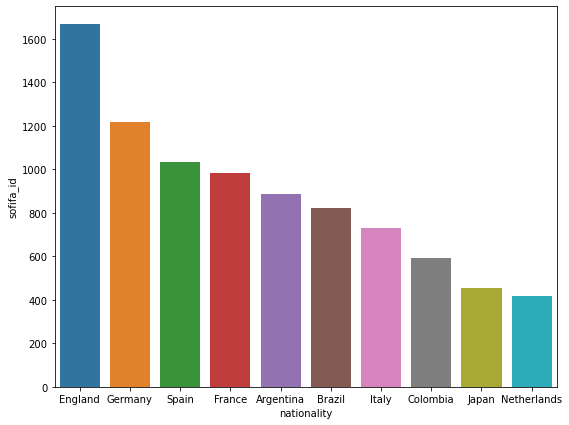

In [406]:
print("Cantidad de Paises:", len(df_original['nationality'].unique()))

plt.figure(figsize=(9,7))

players_by_nat = df_original.groupby('nationality')['sofifa_id'].count().sort_values(ascending=False).reset_index()[:10]
players_by_nat.columns

sns.barplot(data=players_by_nat, x='nationality', y='sofifa_id')

**Podemos ver como se distribuyen los salarios de los jugadores**

<AxesSubplot:>

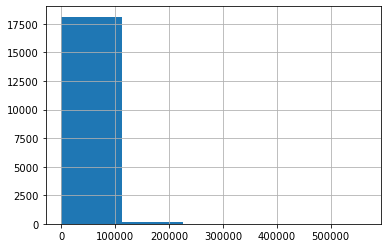

In [407]:
df_original['wage_eur'].hist(bins = 5)

In [408]:
df_original['wage_eur'].describe()

count     18278.000000
mean       9456.942773
std       21351.714095
min           0.000000
25%        1000.000000
50%        3000.000000
75%        8000.000000
max      565000.000000
Name: wage_eur, dtype: float64

**Opah! Parece que la desigualdad entre los salarios tambien "afecta" a los jugadores del FIFA. 
De los 18000 jugadores anotados, mucho menos de 2500 jugadores cobran mas de 100k (2500/18000) ~ 13%**

**La FIFA, ¿es de izquierda o de derecha?**

<AxesSubplot:xlabel='preferred_foot', ylabel='count'>

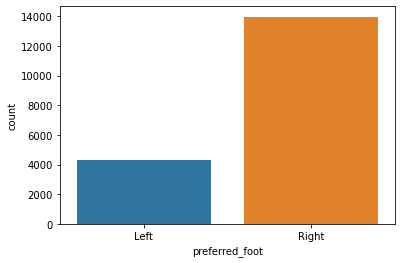

In [409]:
sns.countplot(x=df_original['preferred_foot'])

**A pesar de que hay menos zurdos, en promedio éstos cobran mas sueldo**

In [410]:
df_original.groupby('preferred_foot')['wage_eur'].agg(['mean','std', 'max'])

,mean,std,max
preferred_foot,,,
Left,9959.240389,22810.906660,565000
Right,9301.575931,20878.139851,470000


## Evaluación visual  e intuitiva de a dos variables por vez

### Preparación-de-los-datos

**Retiramos jugadores con bajo Desempeño global ("Overall"), reducimos el tamaño de la base**

**y consideramos Variables de desempeño por habilidad (skills_ratings)**

In [411]:
n = 10000 #cantidad de jugadores a considerar

df = df_original.loc[:n] #se reduce la base a los n primeros jugadores

df = df[(df['overall']>70)]

skills_ratings = ['attacking_crossing',
'attacking_finishing',
'attacking_heading_accuracy',
'attacking_short_passing',
'attacking_volleys',
'skill_dribbling',
'skill_curve',
'skill_fk_accuracy',
'skill_long_passing',
'skill_ball_control',
'movement_acceleration',
'movement_sprint_speed',
'movement_agility',
'movement_reactions',
'movement_balance',
'power_shot_power',
'power_jumping',
'power_stamina',
'power_strength',
'power_long_shots',
'mentality_aggression',
'mentality_interceptions',
'mentality_positioning',
'mentality_vision',
'mentality_penalties',
'mentality_composure',
'defending_marking',
'defending_standing_tackle',
'defending_sliding_tackle',
'goalkeeping_diving',
'goalkeeping_handling',
'goalkeeping_kicking',
'goalkeeping_positioning',
'goalkeeping_reflexes']

print(len(skills_ratings), 'variables numéricas de desempeño según habilidad')

34 variables numéricas de desempeño según habilidad


In [412]:
# Agrupamos los skill de acuerdo a las keyword

attacking_columns = ['attacking_crossing',
'attacking_finishing',
'attacking_heading_accuracy',
'attacking_short_passing',
'attacking_volleys']

skills_columns = ['skill_dribbling',
'skill_curve',
'skill_fk_accuracy',
'skill_long_passing',
'skill_ball_control']

movement_columns=[
'movement_acceleration',
'movement_sprint_speed',
'movement_agility',
'movement_reactions',
'movement_balance']

power_columns=['power_shot_power',
'power_jumping',
'power_stamina',
'power_strength',
'power_long_shots']

mentality_columns=['mentality_aggression',
'mentality_interceptions',
'mentality_positioning',
'mentality_vision',
'mentality_penalties',
'mentality_composure']

defending_columns=['defending_marking',
'defending_standing_tackle',
'defending_sliding_tackle']


goalk_columns=['goalkeeping_diving',
'goalkeeping_handling',
'goalkeeping_kicking',
'goalkeeping_positioning',
'goalkeeping_reflexes']

In [413]:
df.shape

(4756, 104)

In [414]:
df_completa = df.copy()

In [415]:
df = df[skills_ratings] #base, sólo con desempeños según habilidad (numéricas)

In [416]:
df.head(4)

,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes
0,88,95,70,92,88,97,93,94,92,96,91,84,93,95,95,86,68,75,68,94,48,40,94,94,75,96,33,37,26,6,11,15,14,8
1,84,94,89,83,87,89,81,76,77,92,89,91,87,96,71,95,95,85,78,93,63,29,95,82,85,95,28,32,24,7,11,15,14,11
2,87,87,62,87,87,96,88,87,81,95,94,89,96,92,84,80,61,81,49,84,51,36,87,90,90,94,27,26,29,9,9,15,15,11
3,13,11,15,43,13,12,13,14,40,30,43,60,67,88,49,59,78,41,78,12,34,19,11,65,11,68,27,12,18,87,92,78,90,89


### Exploratorio visual para clustering

In [417]:
# Definimos la funcion de visualizacion de skills

def plot_skill_pair(df, skill_1, skill_2):
    graf1 = go.Scatter(x=df[skill_1], y=df[skill_2],
                           mode='markers',
                        text=df_completa.loc[:,'short_name'], #'Height', 'Weight', 'Club', 'Age', 'Name','Position'
                           marker=dict(
                                size=5)
                           )

    data=[graf1]

    layout = go.Layout(title="Visualización de la base de a dos variables numéricas",titlefont=dict(size=10),
                xaxis=dict(title=skill_1),
                yaxis=dict(title=skill_2),
                autosize=False, width=750,height=750)

    fig = go.Figure(data=data, layout=layout)

    iplot(fig)

In [418]:
# Elegimos la siguiente lista de variables a explorar en conjunto:
interesting_skills = ['attacking_finishing','attacking_volleys',
                     'skill_ball_control', 'movement_sprint_speed',
                     'movement_balance', 'power_strength',
                     'power_jumping', 'mentality_vision',
                     'defending_marking', 'goalkeeping_reflexes']

In [419]:
plot_skill_pair(df, 'attacking_finishing','attacking_volleys')

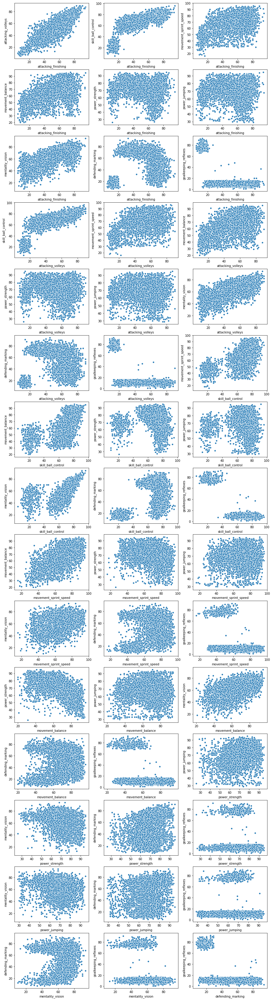

In [420]:
# Veamos ahora como se relacionan todos los skills que destacamos como interesantes.

from itertools import combinations 
comb = combinations(interesting_skills, 2) 
fig, axes = plt.subplots(15, 3, figsize=(15, 60))

f = 0
c = 0

for skill_1, skill_2 in list(comb):
    sns.scatterplot(ax=axes[f, c], data=df, x=skill_1, y=skill_2, s=30)
    
    if c == 2:
        c = 0
        f += 1
    else:
        c += 1
    



### Clustering-con-Kmeans

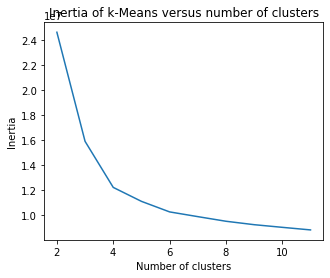

In [421]:
from sklearn.cluster import KMeans

scores = [KMeans(n_clusters=i+2, random_state=10).fit(df).inertia_ for i in range(10)]

from matplotlib import pyplot as plt
plt.figure(figsize=(5,4))
plt.plot(np.arange(2, 12), scores)
plt.xlabel('Number of clusters')
plt.ylabel("Inertia")
plt.title("Inertia of k-Means versus number of clusters")
plt.show()

**Pareceria que un valor n_clusters de 4 ó 5 sería el óptimo. Veamos ahora qué información nos puede dar el análisis de Silhouette**

For n_clusters = 3 The average silhouette_score is : 0.35731495331826296
For n_clusters = 4 The average silhouette_score is : 0.3285163575048322
For n_clusters = 5 The average silhouette_score is : 0.2855927333388514
For n_clusters = 6 The average silhouette_score is : 0.23410740465682306


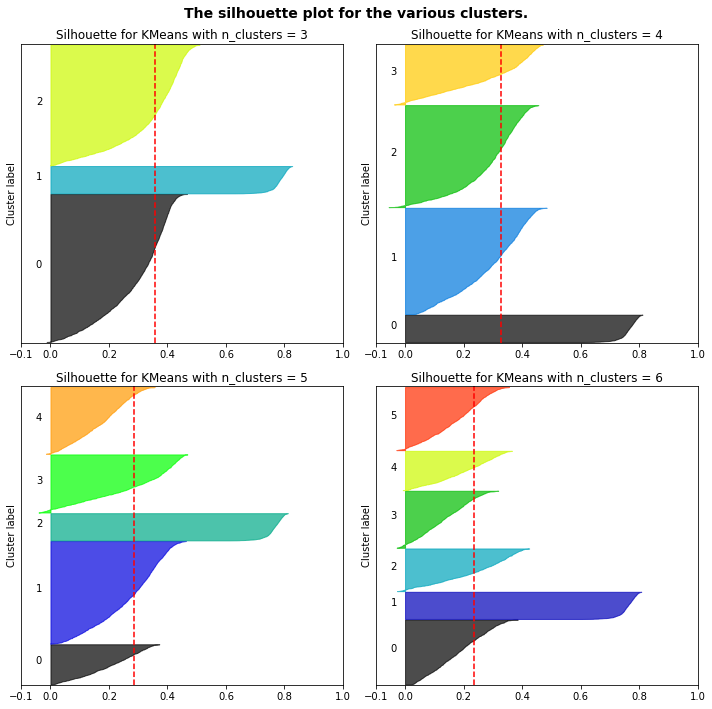

In [422]:
from sklearn.metrics import silhouette_score, silhouette_samples
import matplotlib.cm as cm

# Codigo adaptado from https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html

fig, axes = plt.subplots(2, 2, figsize=(10, 10))

f = 0
c = 0

for n_clusters in [3, 4, 5, 6]:

    # The silhouette coefficient can range from -1, 1. Let set -0.1 for visualization.
    axes[f,c].set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette plots of individual clusters.
    axes[f,c].set_ylim([0, len(df) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(df)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_avg = silhouette_score(df, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(df, cluster_labels)

    y_lower = 10
    
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        axes[f,c].fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        axes[f,c].text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    axes[f,c].set_title("Silhouette for KMeans with n_clusters = %d" % n_clusters)
    axes[f,c].set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    axes[f,c].axvline(x=silhouette_avg, color="red", linestyle="--")

    axes[f,c].set_yticks([])  # Clear the yaxis labels / ticks
    axes[f,c].set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])
    
    ## Para mover los graficos por las filas y columnas del plot
    if c == 1:
        c = 0
        f += 1
    else:
        c += 1


    plt.suptitle(("The silhouette plot for the various clusters."), fontsize=14, fontweight='bold')
    
    
fig.tight_layout()
plt.show()

**Podemos observar que existe un cluster cuyo silhouette score supera con creces a los demas. Este cluster pertenece a los arqueros ya que tienen unos skills muy especificos. A fines de enriquecer el análisis procederemos a quitar a los arqueros del dataset para "emparejar" los datos**

In [423]:
# Veamos si existen jugadores que ademas de ser arqueros, pueden jugar en otra posicion
print('Cantidad de arqueros:', len(df_completa[df_completa['player_positions'].str.contains('.*GK.*')]))
df_completa['player_positions'][df_completa['player_positions'].str.contains('.*GK.*')].unique()

Cantidad de arqueros: 440


array(['GK'], dtype=object)

In [424]:
# Verifiquemos ademas si en la variable team_position hay más arqueros
print('Cantidad de arqueros:', len(df_completa[df_completa['team_position'].str.contains('.*GK.*', na=False)]))

Cantidad de arqueros: 279


In [425]:
# Hay mas arqueros en player_positions que en team_position por lo cual es seguro eliminar los arqueros.

In [426]:
df_completa = df_completa[~df_completa['player_positions'].isin(['GK'])]
df = df_completa.copy()

In [427]:
# Veamos si existen arqueros
print('Cantidad de arqueros:', len(df[df['team_position'].str.contains('.*GK.*', na=False)]))

Cantidad de arqueros: 0


In [428]:
# Considerando que quitamos los arqueros, quitamos tambien los skill especificos relacionados a ellos
skills_ratings = ['attacking_crossing',
'attacking_finishing',
'attacking_heading_accuracy',
'attacking_short_passing',
'attacking_volleys',
'skill_dribbling',
'skill_curve',
'skill_fk_accuracy',
'skill_long_passing',
'skill_ball_control',
'movement_acceleration',
'movement_sprint_speed',
'movement_agility',
'movement_reactions',
'movement_balance',
'power_shot_power',
'power_jumping',
'power_stamina',
'power_strength',
'power_long_shots',
'mentality_aggression',
'mentality_interceptions',
'mentality_positioning',
'mentality_vision',
'mentality_penalties',
'mentality_composure',
'defending_marking',
'defending_standing_tackle',
'defending_sliding_tackle']

In [429]:
# Quitamos las skill de los arqueros y agregamos otra para mantener el numero
interesting_skills = ['attacking_finishing','attacking_volleys',
                     'skill_ball_control', 'movement_sprint_speed',
                     'movement_balance', 'power_strength',
                     'power_jumping', 'mentality_vision',
                     'defending_marking', 'defending_sliding_tackle']

In [430]:
# Nos quedamos solamente con las columnas de skills
df = df[skills_ratings]

Volvamos a realizar el metodo elbow y Silhouette para observar (esperemos) las diferencias 

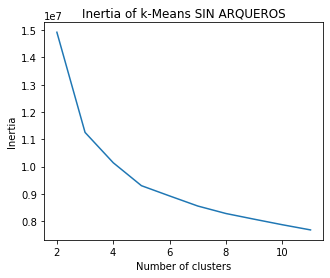

In [431]:
scores = [KMeans(n_clusters=i+2, random_state=10).fit(df).inertia_ for i in range(10)]

plt.figure(figsize=(5,4))
plt.plot(np.arange(2, 12), scores)
plt.xlabel('Number of clusters')
plt.ylabel("Inertia")
plt.title("Inertia of k-Means SIN ARQUEROS")
plt.show()

In [432]:
clusterer = KMeans(n_clusters=n_clusters, random_state=10)
cluster_labels = clusterer.fit_predict(df)

In [433]:
cluster_labels

array([3, 3, 3, ..., 4, 1, 1])

**En princpio parecería que le numero optimo se encuentra en 5 y 6 ahora. Veamos como se comporta Silhouette**

For n_clusters = 3 The average silhouette_score is : 0.28812969021058893
For n_clusters = 4 The average silhouette_score is : 0.2409063280016745
For n_clusters = 5 The average silhouette_score is : 0.18394511239393196
For n_clusters = 6 The average silhouette_score is : 0.161273014017518
For n_clusters = 7 The average silhouette_score is : 0.14428241083502608
For n_clusters = 8 The average silhouette_score is : 0.1320362396507069


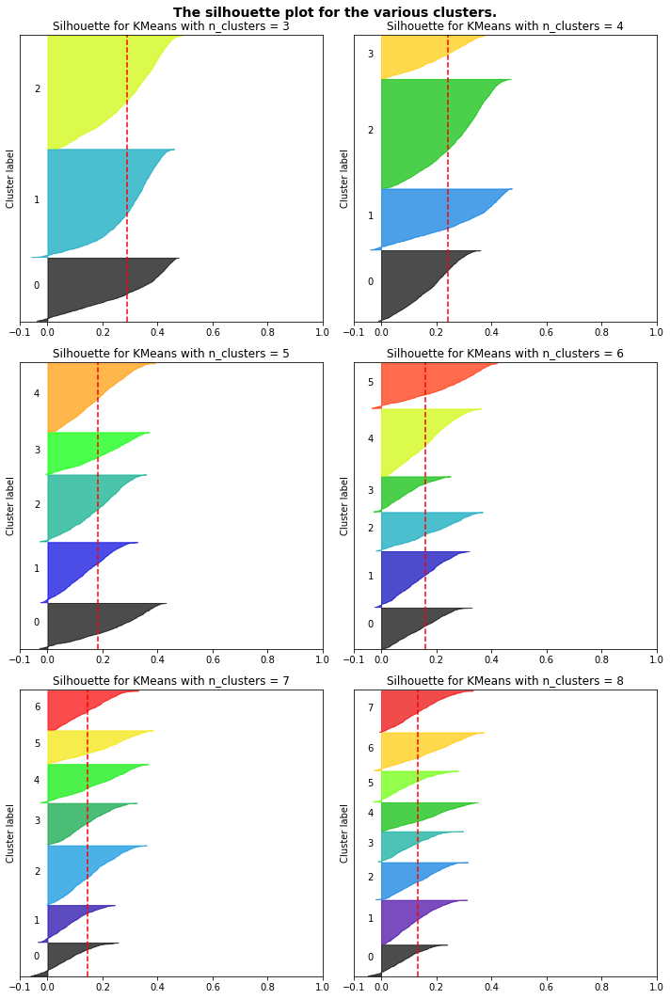

In [434]:
fig, axes = plt.subplots(3, 2, figsize=(10, 15))

f = 0
c = 0

for n_clusters in [3, 4, 5, 6, 7, 8]:

    axes[f,c].set_xlim([-0.1, 1])
    axes[f,c].set_ylim([0, len(df) + (n_clusters + 1) * 10])

    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(df)

    silhouette_avg = silhouette_score(df, cluster_labels)
    print("For n_clusters =", n_clusters, "The average silhouette_score is :", silhouette_avg)

    sample_silhouette_values = silhouette_samples(df, cluster_labels)

    y_lower = 10
    
    for i in range(n_clusters):
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()
        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i
        color = cm.nipy_spectral(float(i) / n_clusters)
        axes[f,c].fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, facecolor=color, edgecolor=color, alpha=0.7)

        axes[f,c].text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        y_lower = y_upper + 10  # 10 for the 0 samples

    axes[f,c].set_title("Silhouette for KMeans with n_clusters = %d" % n_clusters)
    axes[f,c].set_ylabel("Cluster label")
    axes[f,c].axvline(x=silhouette_avg, color="red", linestyle="--")
    axes[f,c].set_yticks([])  # Clear the yaxis labels / ticks
    axes[f,c].set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])
    
    if c == 1:
        c = 0
        f += 1
    else:
        c += 1

    plt.suptitle(("The silhouette plot for the various clusters."), fontsize=14, fontweight='bold')
    
fig.tight_layout()
plt.show()

**Elegimos 5 clusters para continuar con el analisis**

In [435]:
n_clust = 5

km = KMeans(n_clusters=n_clust, random_state=10)
km.fit(df)

# Recuperacion de etiquetas
clusters = km.labels_
print('Suma de los cuadrados de las distancias al cluster / Inertia: ', km.inertia_)

Suma de los cuadrados de las distancias al cluster / Inertia:  9299669.817249324


In [436]:
df_completa['kmeans'] = km.labels_ #clusters

<AxesSubplot:xlabel='kmeans', ylabel='count'>

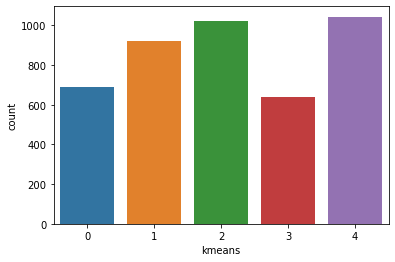

In [437]:
sns.countplot(x=df_completa['kmeans'])

In [438]:
def plot_skills_cluster(df, skill_1, skill_2, cluster):
    graf = go.Scatter(x=df[skill_1], y=df[skill_2],
                           mode='markers',
                        text=df_completa.loc[:,'short_name'], #'Height', 'Weight', 'Club', 'Age', 'Name','Position'
                           marker=dict(size=3,
                                       color = df[cluster].astype(np.float), #set color equal to a variable
                                       colorscale='Portland',
                                       showscale=False)
                     )

    data=[graf]

    layout = go.Layout(title="Visualización de la base de a dos variables numéricas",titlefont=dict(size=10),
                xaxis=dict(title=skill_1),
                yaxis=dict(title=skill_2),
                autosize=False, width=500,height=500)

    fig = go.Figure(data=data, layout=layout)

    iplot(fig)

In [439]:
plot_skills_cluster(df_completa, 'attacking_finishing', 'attacking_volleys', 'kmeans')

In [440]:
def plot_interested_skills_cluster(clusters):
    comb = combinations(interesting_skills, 2)

    fig, axes = plt.subplots(15, 3, figsize=(15, 60))

    f = 0
    c = 0

    for skill_1, skill_2 in list(comb):
        sns.scatterplot(ax=axes[f, c], x=df_completa[skill_1], y=df_completa[skill_2], 
                        hue=df_completa[clusters].tolist(), s=20, palette='bright', markers=False)

        if c == 2:
            c = 0
            f += 1
        else:
            c += 1
    

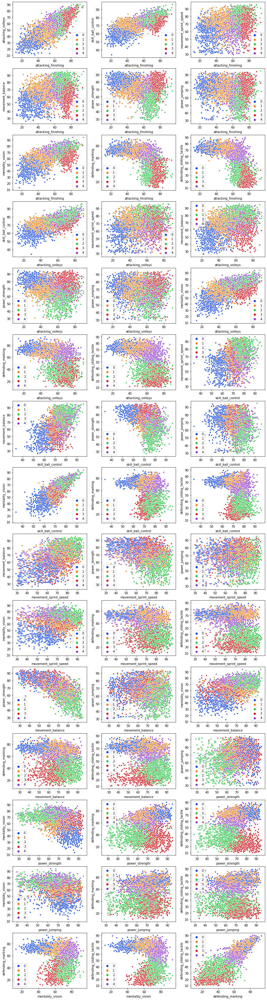

In [441]:
plot_interested_skills_cluster('kmeans')

**Analicemos como se distribuyen los skills en cada cluster**

In [442]:
def plot_skill_by_clusters(clusters):
    
    mskills = {'AT': attacking_columns, 
               'SK': skills_columns,
               'MV': movement_columns, 
               'PW': power_columns,
               'MT': mentality_columns, 
               'DF': defending_columns,
              }

    fig, axes = plt.subplots(3, 2)

    f = 0
    c = 0

    for name, skill in mskills.items():
        df_completa.groupby(clusters)[skill].mean().plot(kind='bar', 
                                                         ax=axes[f,c],
                                                         title=name,
                                                         figsize=(20, 15),
                                                        ).legend(fontsize=14,bbox_to_anchor=(1.05, 1.0), loc='upper left')
        if c == 1:
            f += 1
            c =0
        else:
            c += 1
    fig.tight_layout()

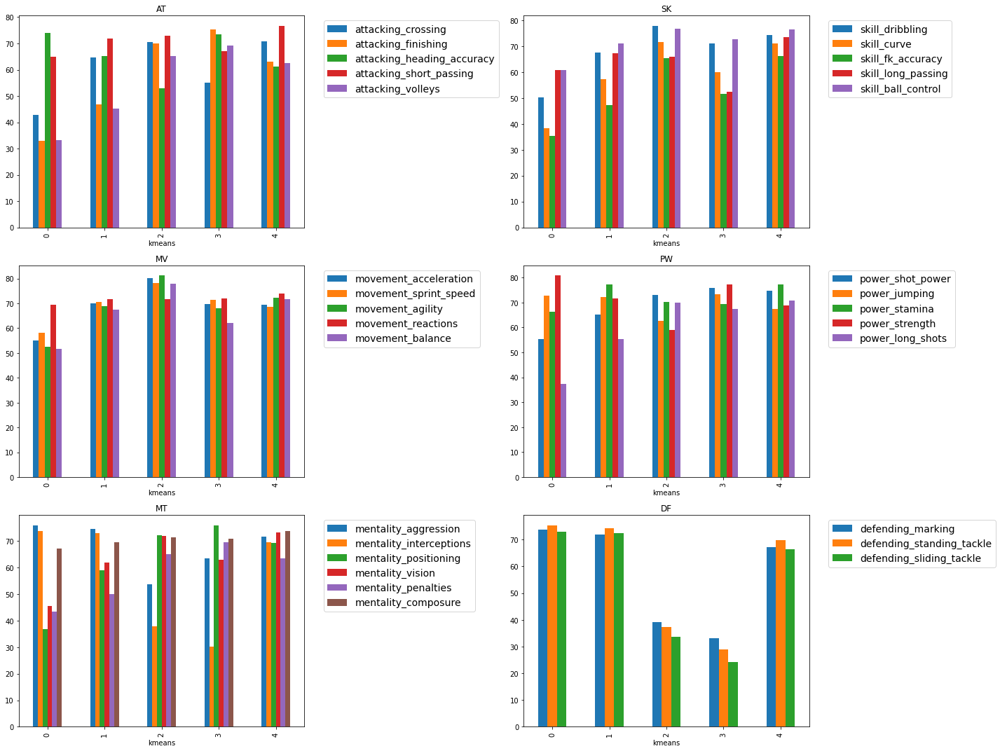

In [443]:
plot_skill_by_clusters('kmeans')

### Clustering-Mean-Shift 


**Veamos como se conforman los clusters a medida que cambiamos el bandwith**

In [444]:
# Definimos una funcion que nos devuelve la cantidad de clusters que encuentra meanshift en base a diferentes bandwidth

def get_ms_clusters(df):
    bw_clt = dict()

    for i in range(106):
        try:
            ms = MeanShift(bandwidth=i, bin_seeding=True)
            ms.fit(df)
            clusters = len(np.unique(ms.labels_))
        except:
            clusters = 0
        finally:
            bw_clt[clusters] = i 
    return pd.DataFrame(bw_clt.items(), columns=['clusters', 'bandwith']).sort_values('clusters')

In [445]:
df_ms_bw = get_ms_clusters(df)
df_ms_bw

,clusters,bandwith
0,0,105
4,1,100
6,2,65
3,3,42
12,4,41
16,5,40
15,7,39
11,9,27
10,10,26
5,11,38


**Para resaltar las diferencias de los diferentes metodos de clustering, decidimos utilizar la misma cantidad de clusters para todos los metodos**

In [446]:
bw = df_ms_bw[df_ms_bw['clusters']==3]['bandwith'].item()

ms = MeanShift(bandwidth=40, bin_seeding=True)
ms.fit(df)

df_completa['meanshift'] = ms.labels_

### Hierarchical Clustering

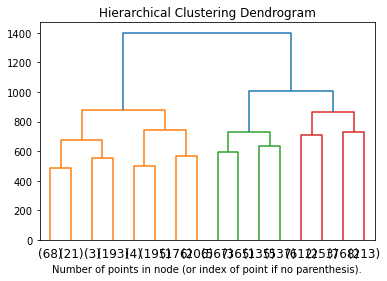

In [447]:
from scipy.cluster.hierarchy import dendrogram
from sklearn.cluster import AgglomerativeClustering


def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack([model.children_, model.distances_,counts]).astype(float)

    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)


# setting distance_threshold=0 ensures we compute the full tree.
model = AgglomerativeClustering(affinity='manhattan', linkage='complete', n_clusters=None, distance_threshold=0)

model = model.fit(df)
plt.title('Hierarchical Clustering Dendrogram')
# plot the top three levels of the dendrogram
plot_dendrogram(model, truncate_mode='level', p=3)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()

In [448]:
from sklearn.cluster import AgglomerativeClustering

# Utilizamos la distancia 'cityblock' (manhattan) https://docs.scipy.org/doc/scipy/reference/generated/scipy.spatial.distance.cityblock.html

h_cluster = AgglomerativeClustering(n_clusters=5, affinity='manhattan', linkage='complete')
h_cluster.fit_predict(df)

h_labels = h_cluster.labels_

In [449]:
df_completa['hierarchical'] = h_cluster.labels_ #clusters

### Análisis de los Clusters Encontrados

#### Veamos los clusters de los diferentes metodos side-by-side

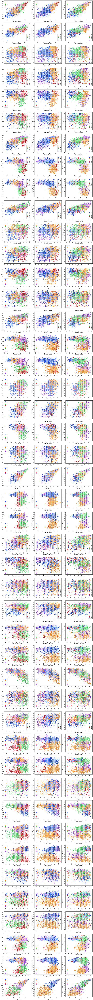

In [450]:
comb = combinations(interesting_skills, 2)

fig, axes = plt.subplots(45, 3, figsize=(15, 160))

f = 0
for skill_1, skill_2 in list(comb):
    sns.scatterplot(ax=axes[f, 0], x=df_completa[skill_1], y=df_completa[skill_2], hue=df_completa['kmeans'].tolist(), s=20, palette='bright', markers=False)
    sns.scatterplot(ax=axes[f, 1], x=df_completa[skill_1], y=df_completa[skill_2], hue=df_completa['meanshift'].tolist(), s=20, palette='bright', markers=False)
    sns.scatterplot(ax=axes[f, 2], x=df_completa[skill_1], y=df_completa[skill_2], hue=df_completa['hierarchical'].tolist(), s=20, palette='bright', markers=False)
    f += 1
fig.tight_layout()


In [451]:
# Es evidente que los diferentes metodos determinan diferentes clusteres
# Veamos ahora como se distribuyen las posiciones de los jugadores en cada cluster segun el metodo de clusterizacion
# Pero primero tenemos que reducir la cantidad de posiciones posibles. Para ellos vamos a elegir una sola de las posibles
# posiciones de cada jugador y luego mapear dicha posicion con la correspondiente afinidad (ataque, defensa, etc.)

In [452]:
def get_position(positions):
    try:
        position = positions.split(',')[0]
    except:
        position = positions
    finally:
        return position

In [453]:
df_completa['new_position'] = df_completa['player_positions'].apply(get_position)

In [454]:
df_completa[['long_name','player_positions','new_position']].sample(10)

,long_name,player_positions,new_position
4080,Ignatius Ganago,"ST, LW",ST
3149,Javier Fabián Toledo,ST,ST
4310,Junior Gabriel Arias Cácerers,ST,ST
4704,Fabián Héctor Sambueza,"RM, CAM",RM
1393,Silvan Widmer,RB,RB
2436,Nicolás Santiago Bertolo,"LM, CAM, RM",LM
3430,Domingos Sousa Coutinho Meneses Duarte,CB,CB
1323,Santiago Lionel Ascacíbar,"CDM, CM",CDM
2251,Ben Gibson,CB,CB
1119,Layvin Kurzawa,"LB, LM",LB


In [455]:
print(df_completa['new_position'].unique())
len(df_completa['new_position'].unique())


['RW' 'ST' 'LW' 'CAM' 'CB' 'CM' 'CDM' 'CF' 'LB' 'RB' 'RM' 'LM' 'LWB' 'RWB']


14

In [456]:
defensor = ['RB', 'CB', 'LB']
mediocampista_def = ['RWB','CDM','LWB']
mediocampista = ['RM', 'CM', 'LM']
mediocampista_of = ['RW', 'CAM', 'LW']
delantero = ['CF', 'ST']

def get_afinidad(position):
    if position in defensor:
        return 'DF'
    
    elif position in mediocampista_def:
        return 'MD'
    
    elif position in mediocampista:
        return 'MC'
    
    elif position in mediocampista_of:
        return 'MO'
    
    elif position in delantero:
        return 'DL'
    else:
        return 'nan'

In [457]:
df_completa['afinidad'] = df_completa['new_position'].apply(get_afinidad)

In [458]:
#Chequeo rapido
df_completa[['long_name','player_positions','new_position','afinidad']].sample(5)

,long_name,player_positions,new_position,afinidad
256,Gelson Dany Batalha Martins,"RM, RW",RM,MC
412,Nicolò Barella,"CM, CAM",CM,MC
4408,Hueglo dos Santos Neris,CB,CB,DF
423,Marcos Llorente Moreno,CDM,CDM,MD
3620,Luke Ayling,RB,RB,DF


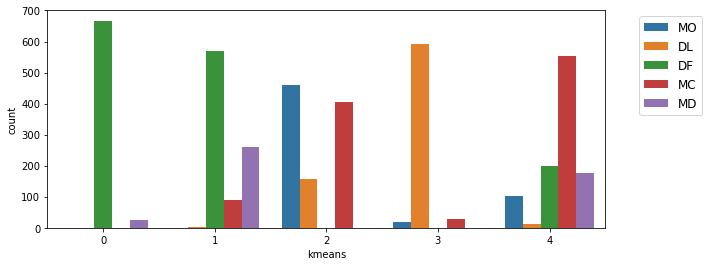

In [538]:
plt.figure(figsize=(10,4))
sns.countplot(data=df_completa, x='kmeans', hue='afinidad').legend(fontsize=12,bbox_to_anchor=(1.05, 1.0), loc='upper left')

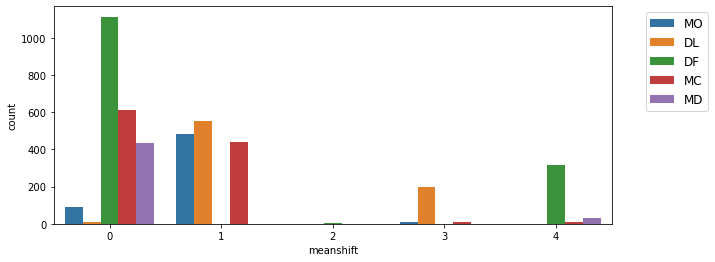

In [541]:
plt.figure(figsize=(10,4))
sns.countplot(data=df_completa, x='meanshift', hue='afinidad').legend(fontsize=12,bbox_to_anchor=(1.05, 1.0), loc='upper left')

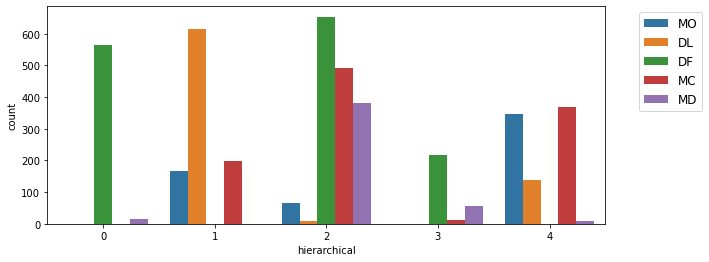

In [542]:
plt.figure(figsize=(10,4))
sns.countplot(data=df_completa, x='hierarchical', hue='afinidad').legend(fontsize=12,bbox_to_anchor=(1.05, 1.0), loc='upper left')

## Embeddings y técnicas de clustering

### tSNE - ¿Cuantos clusters encontrará MeanShift o kMedias para las primeras 2 componentes de tSNE?

In [462]:
from sklearn import (manifold, decomposition)

tsne = manifold.TSNE(n_components=2, verbose=1,perplexity=30, n_iter=1000)
X_tsne = tsne.fit_transform(df)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 4316 samples in 0.030s...
[t-SNE] Computed neighbors for 4316 samples in 0.856s...
[t-SNE] Computed conditional probabilities for sample 1000 / 4316
[t-SNE] Computed conditional probabilities for sample 2000 / 4316
[t-SNE] Computed conditional probabilities for sample 3000 / 4316
[t-SNE] Computed conditional probabilities for sample 4000 / 4316
[t-SNE] Computed conditional probabilities for sample 4316 / 4316
[t-SNE] Mean sigma: 12.296204
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.780014
[t-SNE] KL divergence after 1000 iterations: 1.869762


In [463]:
bool_defensor = df_completa['afinidad'] == 'DF'
bool_med_def = df_completa['afinidad'] == 'MD'
bool_med = df_completa['afinidad'] == 'MC'
bool_med_of = df_completa['afinidad'] == 'MO'
bool_delantero = df_completa['afinidad'] == 'DL'

#graficamos los datos en el espacio transformado: las dos componentes tsne
palette=['navy','red','#A2D5F2','orange','green','pink']  

defensores = go.Scatter(x=X_tsne[bool_defensor,0], y=X_tsne[bool_defensor,1],name='Defensores',
                      opacity=0.9,marker=dict(color=palette[2],size=5),mode='markers')

med_def = go.Scatter(x=X_tsne[bool_med_def,0], y=X_tsne[bool_med_def,1],name='Mediocampista Defensor',
                      opacity=0.6,marker=dict(color=palette[1],size=5),mode='markers')

mediocampista = go.Scatter(x=X_tsne[bool_med,0], y=X_tsne[bool_med,1],name='Mediocampista',
                      opacity=0.7,marker=dict(color=palette[3],size=5),mode='markers')

med_of = go.Scatter(x=X_tsne[bool_med_of,0], y=X_tsne[bool_med_of,1],name='Mediocampista Atacante',
                      opacity=0.4,marker=dict(color=palette[4],size=5),mode='markers')

delantero = go.Scatter(x=X_tsne[bool_delantero,0], y=X_tsne[bool_delantero,1],name='Delantero',
                      opacity=0.9,marker=dict(color=palette[0],size=5),mode='markers')

data=[defensores, med_def, mediocampista, med_of, delantero]


layout = go.Layout(title="Visualización de la base en el espacio tsne",titlefont=dict(size=20),
                xaxis=dict(title='componente 1'),
                yaxis=dict(title='componente 2'),
                autosize=False, width=1000,height=1000)

fig = go.Figure(data=data, layout=layout)

#iplot(fig)
plot(fig)

'temp-plot.html'

In [464]:
# Veamos con kMeans cual seria la cantidad de cluster óptima utilizando el metodo elbow

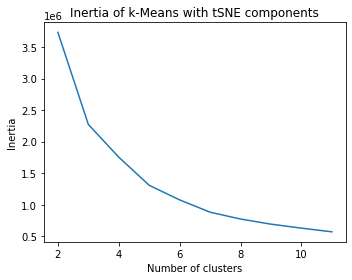

In [465]:
scores = [KMeans(n_clusters=i+2, random_state=10).fit(X_tsne).inertia_ for i in range(10)]

plt.figure(figsize=(5,4))
plt.plot(np.arange(2, 12), scores)
plt.xlabel('Number of clusters')
plt.ylabel("Inertia")
plt.title("Inertia of k-Means with tSNE components")
plt.tight_layout()
plt.show()

In [466]:
# Podemos observar que el rango óptimo se encuentra entre 5 y 7.

In [467]:
# Veamos cuantos encuentra Meanshifts si utilizamos bw de 0 a 100

In [468]:
# Mean Shift
# Veamos cuantos clusters encuentra con las componentes de PCA
df_tsne_ms_bw = get_ms_clusters(X_tsne)[:10]
df_tsne_ms_bw

,clusters,bandwith
0,0,0
22,1,105
21,2,57
20,3,32
19,4,25
18,5,23
17,6,19
16,7,18
15,8,16
14,10,15


In [469]:
# Como hicimos anteriormente, veamos como quedan los datos agrupados considerando los clusters definidos a partir de las componentes tSNE
# comparado con la division por defecto a la posicion de los jugadores

In [470]:
df_tsne = pd.DataFrame(X_tsne)

In [471]:
n_clust = 5

km = KMeans(n_clusters=n_clust, random_state=10)
km.fit(X_tsne)

df_completa['tsne_kmeans'] = km.labels_

In [472]:
#bw = 22 # Encuentra 5 clusters
bw = df_tsne_ms_bw[df_tsne_ms_bw['clusters']==5]['bandwith'].item()
ms = MeanShift(bandwidth=bw, bin_seeding=True)
ms.fit(X_tsne)

df_completa['tsne_meanshifht'] = ms.labels_

**Dibujemos los datos originales con sus datos agrupados por posicion y los datos agrupados segun lo que encontraron KMedias y Meanshift utilizando las componentes tSNE**

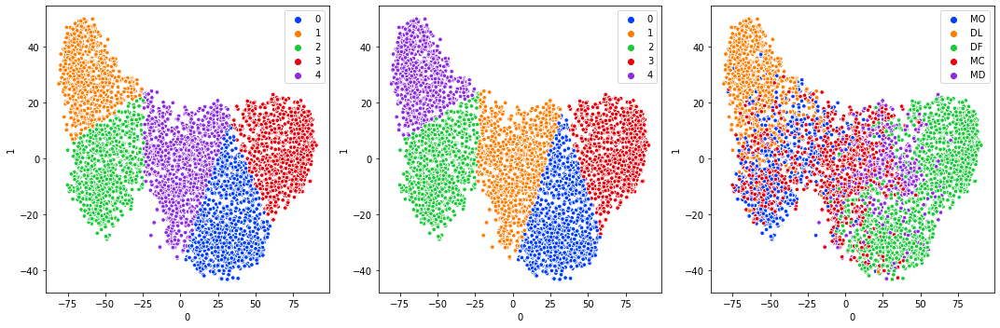

In [473]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

sns.scatterplot(ax=axes[0], x=df_tsne[0], y=df_tsne[1], hue=df_completa['tsne_kmeans'].tolist(), s=20, palette='bright', markers=False)
sns.scatterplot(ax=axes[1], x=df_tsne[0], y=df_tsne[1], hue=df_completa['tsne_meanshifht'].tolist(), s=20, palette='bright', markers=False)
sns.scatterplot(ax=axes[2], x=df_tsne[0], y=df_tsne[1], hue=df_completa['afinidad'].tolist(), s=20, palette='bright', markers=False)

fig.tight_layout()
# kmeans, meanshift y original (de izq a der respectivamente)

Se hace evidente que los grupos mas definidos son los delanteros y los defensores. A partir de ahi el resto de las posiciones se dota de jugadores de skills variados pero mas balanceados lo que les permite jugar en varias posiciones.

Utilizar estas tecnicas nos ayudaría a mejorar la asignacion de posiciones que hicimos anteriormente cuando ante la aparicion de varias posiciones posibles seleccionabamos la primera. Con la ayuda de tsne y kmeans (por ejemplo) podriamos realizar una selección mas objetiva.

### PCA

In [474]:
from sklearn import preprocessing
std_scale=preprocessing.StandardScaler().fit(df)
X_scaled=std_scale.transform(df) # numpyarray normalizado por columna

In [475]:
X_scaled

array([[ 1.85191727,  2.22591719,  0.50579762, ..., -1.29845475,
        -1.00858184, -1.34122585],
       [ 1.55947807,  2.16540639,  2.10231142, ..., -1.56314263,
        -1.24990788, -1.43455936],
       [ 1.77880747,  1.74183075, -0.16641871, ..., -1.61608021,
        -1.53949914, -1.20122559],
       ...,
       [ 0.5359409 , -0.31553665, -0.25044575, ...,  0.60729802,
         0.63243527,  0.47877754],
       [-0.34137668, -0.25502585,  0.33774354, ...,  0.71317317,
         0.72896569,  0.80544481],
       [-1.07247467, -0.98115552,  0.08566242, ...,  0.39554771,
         0.58417006,  0.6187778 ]])

In [522]:
from sklearn import decomposition
pca = decomposition.PCA(n_components=4) 
# Probamos con varios pero por algun motivo a veces no converge el algoritmo (ver codigo comentado en el box
#de abajo)
converged = False
while not converged:
    try:
        pca.fit(X_scaled) #input data is centered but not scaled for each feature before applying the SVD
        converged = True
    except:
        pass

# proporción de varianza
print('proporción de varianza por componente: ', pca.explained_variance_ratio_)
# proporción de varianza acumulada
print('proporción de varianza por componente acumulada: ', pca.explained_variance_ratio_.cumsum())

X_projected = pca.transform(X_scaled) #numpy array
print('tamaño de los datos: ', X_projected.shape)

proporción de varianza por componente:  [0.41539732 0.1628158  0.10483924 0.06417477]
proporción de varianza por componente acumulada:  [0.41539732 0.57821312 0.68305237 0.74722714]
tamaño de los datos:  (4316, 4)


In [523]:
#
# A veces converge y otras veces no para la misma cantidad de componentes
#

# for i in range(3,6):
#     try:
#         pca = decomposition.PCA(n_components=i) #elegimos 2, 3 o 4 pero pueden ser más, 
#         pca.fit(X_scaled)
    
#         sns.barplot(y=pca.explained_variance_ratio_, x=[x for x in range(0,len(pca.explained_variance_ratio_))])
#     except:
#         print(i)


In [524]:
X_projected

array([[-9.58406498, -3.37115846,  1.94861083, -1.15375416],
       [-7.71157229, -1.80571657,  3.76234143, -4.41299058],
       [-9.2537746 , -2.0806064 ,  0.83786338, -0.92178306],
       ...,
       [ 0.69563495, -1.48943659,  0.21999467,  1.03814894],
       [ 1.74626837, -0.49293041,  0.34344205,  0.3690258 ],
       [ 3.35934389, -0.13373219, -0.89883407, -0.01364219]])

**Hacemos lo mismo que con tSNE, vamos a buscar clusters y ver graficamente como quedan agrupados los jugadores**

In [525]:
df_pca = pd.DataFrame(X_projected[:,0:2])

#### PCA - Mean Shift

In [526]:
# Mean Shift
# Veamos cuantos clusters encuentra con las componentes de PCA
df_pca_ms_bw = get_ms_clusters(df_pca)[:10]
df_pca_ms_bw

,clusters,bandwith
0,0,0
4,1,105
3,2,3
2,3,2
1,12,1


In [527]:
# Podemos ver que probando con distintos valores de BW (entre 0 y 100 segun el método) no encuentra 5 clusters
# (como lo venimos trabajando) sino que identifica 3. Por lo tanto continuaremos el análisis con 3 clusters

In [528]:
# Encuentra 3 clusters (no conseguimos encontrar un BW que nos encontrara 5 clusters)
bw = df_pca_ms_bw[df_pca_ms_bw['clusters']==3]['bandwith'].item()

ms = MeanShift(bandwidth=bw, bin_seeding=True)
ms.fit(df_pca)

df_completa['pca_meanshifht'] = ms.labels_

#### PCA K Means

In [529]:
# KMeans
n_clust = 3

km = KMeans(n_clusters=n_clust, random_state=10)
km.fit(df_pca)

df_completa['pca_kmeans'] = km.labels_

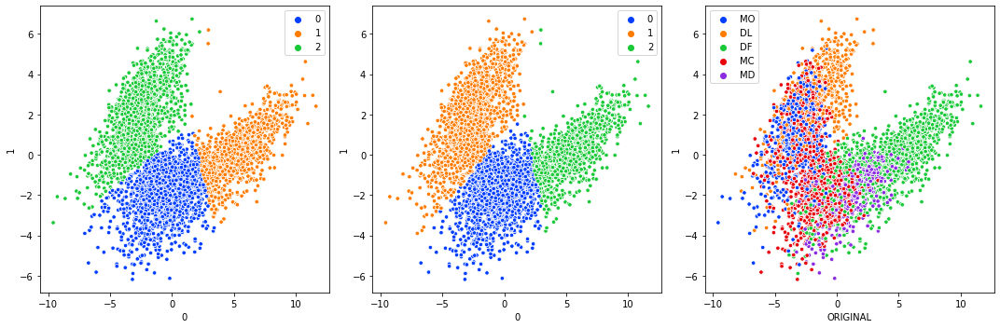

In [530]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

sns.scatterplot(ax=axes[0], x=df_pca[0], y=df_pca[1], hue=df_completa['pca_kmeans'].tolist(), s=20, palette='bright', markers=False)
axes[2].xaxis.set_label_text('KMEANS')

sns.scatterplot(ax=axes[1], x=df_pca[0], y=df_pca[1], hue=df_completa['pca_meanshifht'].tolist(), s=20, palette='bright', markers=False)
axes[2].xaxis.set_label_text('MEANSHIFT')

sns.scatterplot(ax=axes[2], x=df_pca[0], y=df_pca[1], hue=df_completa['afinidad'].tolist(), s=20, palette='bright', markers=False)
axes[2].xaxis.set_label_text('ORIGINAL')

fig.tight_layout()

**Veamos si podemos agrupar las afinidades en 3 categorias y de esta manera igualar la cantidad de grupos**

In [531]:
defensores = ['DF']
mediocampistas = ['MD', 'MC', 'MO']
delanteros = ['DL']

def get_afinidad_general(position):
    
    if position in defensores:
        return 'defensa'
    elif position in mediocampistas:
        return 'mediocampo' 
    elif position in delanteros:
        return 'delantera'
    else:
        return 'nan'

In [532]:
df_completa['new_afinidad'] = df_completa['afinidad'].apply(get_afinidad_general)

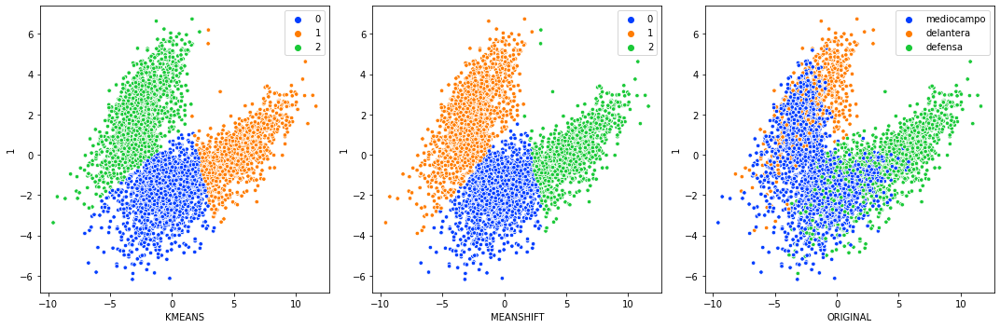

In [533]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

sns.scatterplot(ax=axes[0], x=df_pca[0], y=df_pca[1], hue=df_completa['pca_kmeans'].tolist(), s=20, palette='bright', markers=False)
axes[0].xaxis.set_label_text('KMEANS')

sns.scatterplot(ax=axes[1], x=df_pca[0], y=df_pca[1], hue=df_completa['pca_meanshifht'].tolist(), s=20, palette='bright', markers=False)
axes[1].xaxis.set_label_text('MEANSHIFT')

sns.scatterplot(ax=axes[2], x=df_pca[0], y=df_pca[1], hue=df_completa['new_afinidad'].tolist(), s=20, palette='bright', markers=False)
axes[2].xaxis.set_label_text('ORIGINAL')

fig.tight_layout()

Podemos ver que los algoritmos de clusterizacion encuentran agrupaciones similares con las componentes de PCA. 

Si comparamos con los datos reales gran parte de las observaciones proyectadas en PCA coinciden con el agrupamiento por posicion que establecemos 'a priori' (por ejemplo, Cluster 1 de Kmeans es igual al Cluster 2 de meanshift que a su vez cotienen a muchos jugadores etiquetados de defensa).

